In [3]:
library(dplyr)
bateo<-read.csv("/home/max/Documents/tabla_chida.csv")
library(factoextra)
library(ClusterR)
library(cluster)
head(bateo)

,X,No,JUGADOR,Pos,EQUIPO,J,TB,C,H,X2B,⋯,HR,CI,BB,P,BR,AR,PRO,OBP,SLG,OPS
,<int>,<int>,<chr>,<chr>,<chr>,<int>,<int>,<int>,<int>,<int>,⋯,<int>,<int>,<int>,<int>,<int>,<int>,<dbl>,<dbl>,<dbl>,<dbl>
1,1,1,ChrisCarter,DH,PUE,63,200,45,56,13,⋯,22,64,57,79,0,0,0.280,0.449,0.685,1.134
2,2,2,FernandoVillegas,RF,SLT,75,267,47,104,9,⋯,16,58,22,45,5,6,0.390,0.452,0.625,1.077
3,3,3,OswaldoArcia,DH,GDL,83,273,64,91,23,⋯,14,60,73,65,2,2,0.330,0.482,0.579,1.061
4,4,4,JulianOrnelas,CF,MEX,86,349,78,123,31,⋯,14,71,63,60,8,4,0.352,0.451,0.573,1.024
5,5,5,RainelRosario,LF,SLT,74,272,51,90,17,⋯,17,49,45,54,2,3,0.331,0.429,0.581,1.010
6,6,6,ReynaldoRodriguez,1B,TIG,76,307,51,113,18,⋯,16,62,25,28,4,4,0.368,0.412,0.590,1.002


Ejercicio 1

In [4]:
#Primera tabla Jugador, JJ, PRO, OBP.
bateo_1<-bateo[,-c(1,2,4,5,7,8,9,10,11,12,13,14,15,16,17,20,21)]
head(bateo_1,n=3)

,JUGADOR,J,PRO,OBP
,<chr>,<int>,<dbl>,<dbl>
1,ChrisCarter,63,0.28,0.449
2,FernandoVillegas,75,0.39,0.452
3,OswaldoArcia,83,0.33,0.482


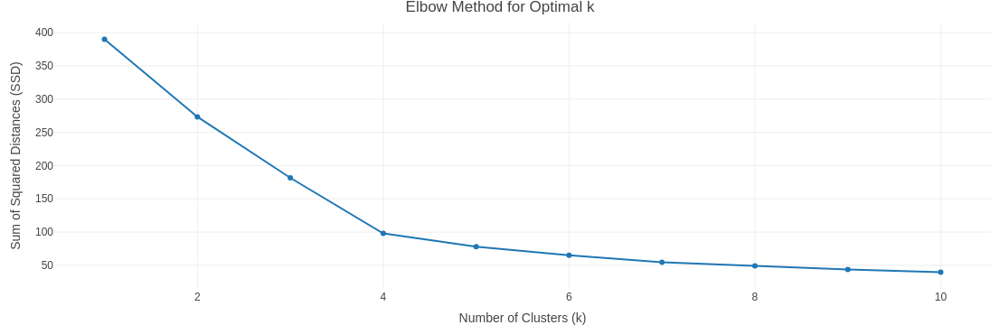

In [10]:
library(plotly)
set.seed(123) 
bat1<-bateo_1
bat1<-as.data.frame(scale(bateo_1[,2:4]))
k_values <- 1:10
max_iterations <- 100
n_init <- 10
ssd <- numeric(length(k_values))
for (i in seq_along(k_values)) {
  k <- k_values[i]
  kmeans_result <- kmeans(bat1, centers = k, nstart = n_init, iter.max = max_iterations)
  ssd[i] <- kmeans_result$tot.withinss
}
elbow_data <- data.frame(k = k_values, ssd = ssd)
elbow_plot <- plot_ly(data = elbow_data, x = ~k, y = ~ssd, type = 'scatter', mode = 'lines+markers') %>%
  layout(title = "Elbow Method for Optimal k",
         xaxis = list(title = "Number of Clusters (k)"),
         yaxis = list(title = "Sum of Squared Distances (SSD)"))
elbow_plot

In [11]:
segmentos<-kmeans(bat1,3)
head(bat1)
segmentos

,J,PRO,OBP
,<dbl>,<dbl>,<dbl>
1,-2.0900861,-0.48602081,1.2666560
2,-0.3797189,0.21606699,1.3090758
3,0.7605259,-0.16688999,1.7332733
4,1.1881177,-0.02647243,1.2949358
5,-0.5222495,-0.16050737,0.9838576
6,-0.2371883,0.07564943,0.7434790


K-means clustering with 3 clusters of sizes 65, 49, 17

Cluster means:
            J        PRO         OBP
1  0.76271864 -0.3594813 -0.08990597
2 -1.02837859 -0.3679207  0.18855941
3  0.04787287  2.4349648 -0.19973666

Clustering vector:
  [1] 2 2 1 1 2 2 2 1 1 1 1 1 2 1 1 1 1 1 2 1 2 1 1 1 2 2 1 2 2 1 1 2 2 2 1 1 1
 [38] 1 2 2 1 1 2 2 1 1 1 1 2 2 2 1 1 2 2 1 2 2 1 1 2 1 1 1 2 2 2 1 1 1 2 1 2 1
 [75] 2 2 2 1 1 2 2 2 1 1 1 2 1 1 1 1 1 1 2 2 1 1 1 2 2 2 2 1 2 1 1 2 1 1 1 1 2
[112] 1 3 3 3 3 3 3 3 3 3 3 2 3 3 1 3 3 3 3 3

Within cluster sum of squares by cluster:
[1] 103.23603  60.53013  17.78887
 (between_SS / total_SS =  53.4 %)

Available components:

[1] "cluster"      "centers"      "totss"        "withinss"     "tot.withinss"
[6] "betweenss"    "size"         "iter"         "ifault"      

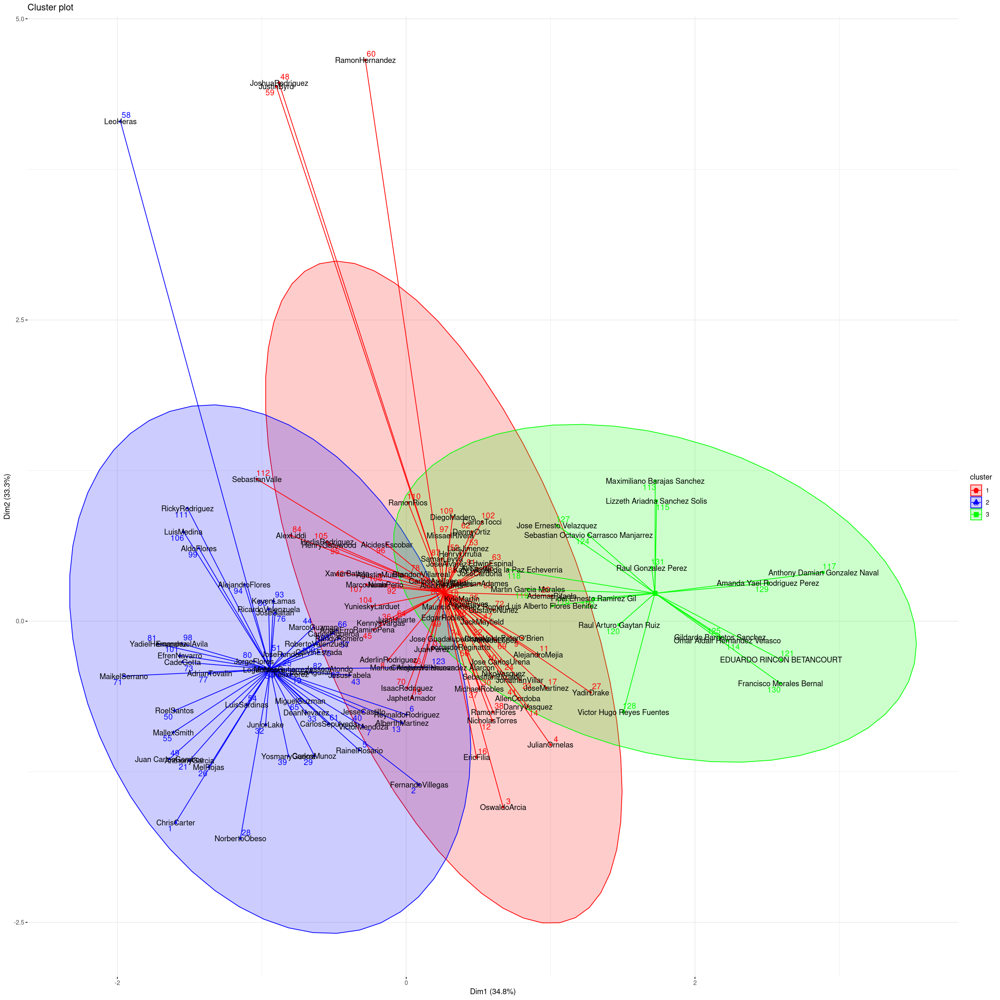

In [12]:
options(repr.plot.width=20, repr.plot.height=20)
basic_colors <- c("red", "blue", "green", "yellow", "purple", "orange", "cyan", "magenta", "brown", "black")
library(ggplot2)
library(factoextra)
cluster_plot <- fviz_cluster(segmentos, data = bat1,
                            palette = basic_colors[1:4], 
                            ellipse.type = "norm",
                            star.plot = TRUE,
                            repel = TRUE,
                            ggtheme = theme_minimal()
)
cluster_plot <- cluster_plot + 
  geom_text(aes(label = bateo[,3]))
print(cluster_plot)

In [13]:
asignacion<-cbind(bateo_1,cluster =segmentos$cluster)
head(asignacion,4)
write.csv(asignacion,"tabla_1_cluster3.csv")

,JUGADOR,J,PRO,OBP,cluster
,<chr>,<int>,<dbl>,<dbl>,<int>
1,ChrisCarter,63,0.280,0.449,2
2,FernandoVillegas,75,0.390,0.452,2
3,OswaldoArcia,83,0.330,0.482,1
4,JulianOrnelas,86,0.352,0.451,1


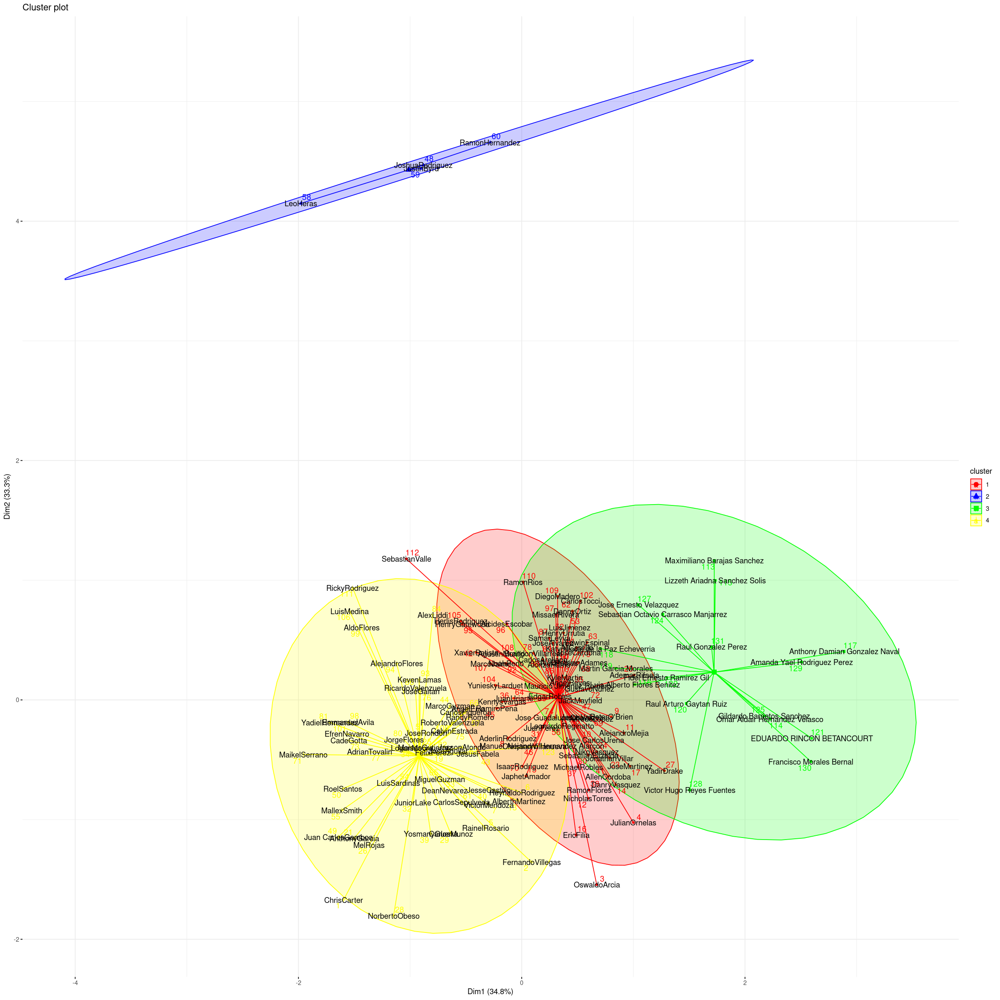

In [14]:
segmentos<-kmeans(bat1,4)
options(repr.plot.width=20, repr.plot.height=20)
basic_colors <- c("red", "blue", "green", "yellow", "purple", "orange", "cyan", "magenta", "brown", "black")
library(ggplot2)
library(factoextra)
cluster_plot <- fviz_cluster(segmentos, data = bat1,
                            palette = basic_colors[1:4], 
                            ellipse.type = "norm",
                            star.plot = TRUE,
                            repel = TRUE,
                            ggtheme = theme_minimal()
)
cluster_plot <- cluster_plot + 
  geom_text(aes(label = bateo[,3]))
print(cluster_plot)

In [15]:
asignacion<-cbind(bateo_1,cluster =segmentos$cluster)
head(asignacion,4)
write.csv(asignacion,"tabla_1_cluster4.csv")

,JUGADOR,J,PRO,OBP,cluster
,<chr>,<int>,<dbl>,<dbl>,<int>
1,ChrisCarter,63,0.280,0.449,4
2,FernandoVillegas,75,0.390,0.452,4
3,OswaldoArcia,83,0.330,0.482,1
4,JulianOrnelas,86,0.352,0.451,1


Ejercicio 2

In [16]:
#Segunda tabla TB, CI, HR
bateo_2<-bateo[,-c(1,2,3,4,5,6,8,9,10,11,14,15,16,17,18,19,20,21)]
bat2<-bateo_2
bat2<-as.data.frame(scale(bateo_2))
head(bat2)

,TB,HR,CI
,<dbl>,<dbl>,<dbl>
1,-2.3500251,2.3352807,1.3219549
2,-0.5468806,1.3063958,0.9270265
3,-0.3854049,0.9634342,1.0586693
4,1.6599531,0.9634342,1.7827046
5,-0.4123175,1.4778767,0.3346340
6,0.5296236,1.3063958,1.1903121


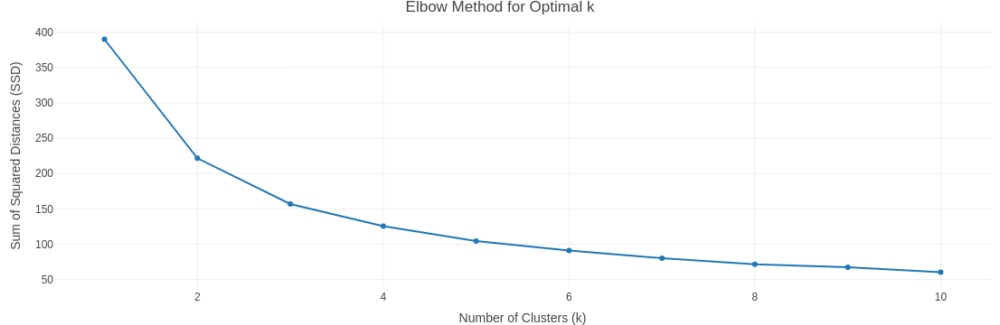

In [17]:
set.seed(123) 
k_values <- 1:10
max_iterations <- 100
n_init <- 10
ssd <- numeric(length(k_values))
for (i in seq_along(k_values)) {
  k <- k_values[i]
  kmeans_result <- kmeans(bat2, centers = k, nstart = n_init, iter.max = max_iterations)
  ssd[i] <- kmeans_result$tot.withinss
}
elbow_data <- data.frame(k = k_values, ssd = ssd)
elbow_plot <- plot_ly(data = elbow_data, x = ~k, y = ~ssd, type = 'scatter', mode = 'lines+markers') %>%
  layout(title = "Elbow Method for Optimal k",
         xaxis = list(title = "Number of Clusters (k)"),
         yaxis = list(title = "Sum of Squared Distances (SSD)"))
elbow_plot

In [19]:
segmentos<-kmeans(bat2,3)
head(bat2)
segmentos

,TB,HR,CI
,<dbl>,<dbl>,<dbl>
1,-2.3500251,2.3352807,1.3219549
2,-0.5468806,1.3063958,0.9270265
3,-0.3854049,0.9634342,1.0586693
4,1.6599531,0.9634342,1.7827046
5,-0.4123175,1.4778767,0.3346340
6,0.5296236,1.3063958,1.1903121


K-means clustering with 3 clusters of sizes 49, 40, 42

Cluster means:
          TB         HR         CI
1 -1.0093380 -0.4434084 -0.6392540
2  0.4771441  1.1177669  1.1656290
3  0.7231381 -0.5472301 -0.3643266

Clustering vector:
  [1] 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 3 2 2 2 2 1 2 2 2 2 1 2 1 1 2 2 1 1 1 2 2 3
 [38] 3 1 1 3 2 3 1 3 3 2 1 1 1 1 2 2 1 1 3 3 1 3 2 1 2 2 2 1 1 1 3 3 3 1 3 1 3
 [75] 1 1 1 3 3 1 1 1 3 1 1 1 3 1 1 3 3 3 1 1 1 3 3 1 1 1 1 3 1 3 3 1 1 3 3 3 1
[112] 1 3 3 3 2 3 1 3 2 3 3 1 2 3 1 3 2 3 3 3

Within cluster sum of squares by cluster:
[1] 54.81299 62.53884 39.52560
 (between_SS / total_SS =  59.8 %)

Available components:

[1] "cluster"      "centers"      "totss"        "withinss"     "tot.withinss"
[6] "betweenss"    "size"         "iter"         "ifault"      

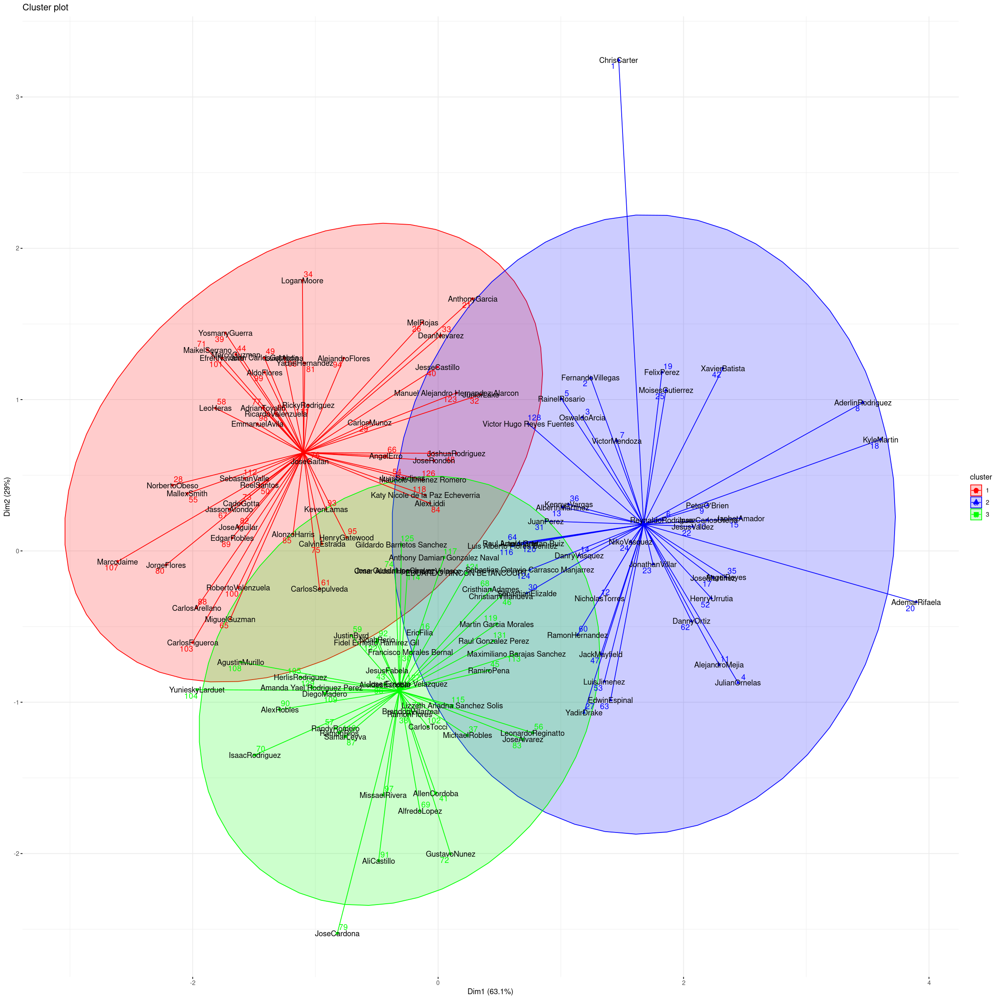

In [21]:
options(repr.plot.width=20, repr.plot.height=20)
basic_colors <- c("red", "blue", "green", "yellow", "purple", "orange", "cyan", "magenta", "brown", "black")
cluster_plot <- fviz_cluster(segmentos, data = bat2,
                            palette = basic_colors[1:3], 
                            ellipse.type = "norm",
                            star.plot = TRUE,
                            repel = TRUE,
                            ggtheme = theme_minimal() 
)
cluster_plot <- cluster_plot + 
  geom_text(aes(label = bateo[,3]))
print(cluster_plot)

In [22]:
segmentos<-kmeans(bat2,2)
asignacion<-cbind(bateo_2,cluster =segmentos$cluster)
head(asignacion,4)
write.csv(asignacion,"tabla_2_cluster3.csv")

,TB,HR,CI,cluster
,<int>,<int>,<int>,<int>
1,200,22,64,1
2,267,16,58,1
3,273,14,60,1
4,349,14,71,1


In [27]:
segmentos<-kmeans(bat2,2)
head(bat2)
segmentos

,TB,HR,CI
,<dbl>,<dbl>,<dbl>
1,-2.3500251,2.3352807,1.3219549
2,-0.5468806,1.3063958,0.9270265
3,-0.3854049,0.9634342,1.0586693
4,1.6599531,0.9634342,1.7827046
5,-0.4123175,1.4778767,0.3346340
6,0.5296236,1.3063958,1.1903121


K-means clustering with 2 clusters of sizes 81, 50

Cluster means:
          TB         HR         CI
1 -0.2890512 -0.5693079 -0.6209952
2  0.4682629  0.9222788  1.0060122

Clustering vector:
  [1] 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 1 2 2 2 2 2 2 2 2 2 1 2 1 1 2 2 2 1 1 2 2 1
 [38] 1 1 1 1 2 1 1 2 2 2 1 1 1 1 2 2 1 1 2 1 1 1 2 1 2 2 2 1 1 1 2 1 1 1 1 1 1
 [75] 1 1 1 1 1 1 1 1 2 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
[112] 1 2 1 1 2 1 1 2 2 1 1 1 2 1 1 1 2 1 1 2

Within cluster sum of squares by cluster:
[1] 134.38641  87.26009
 (between_SS / total_SS =  43.2 %)

Available components:

[1] "cluster"      "centers"      "totss"        "withinss"     "tot.withinss"
[6] "betweenss"    "size"         "iter"         "ifault"      

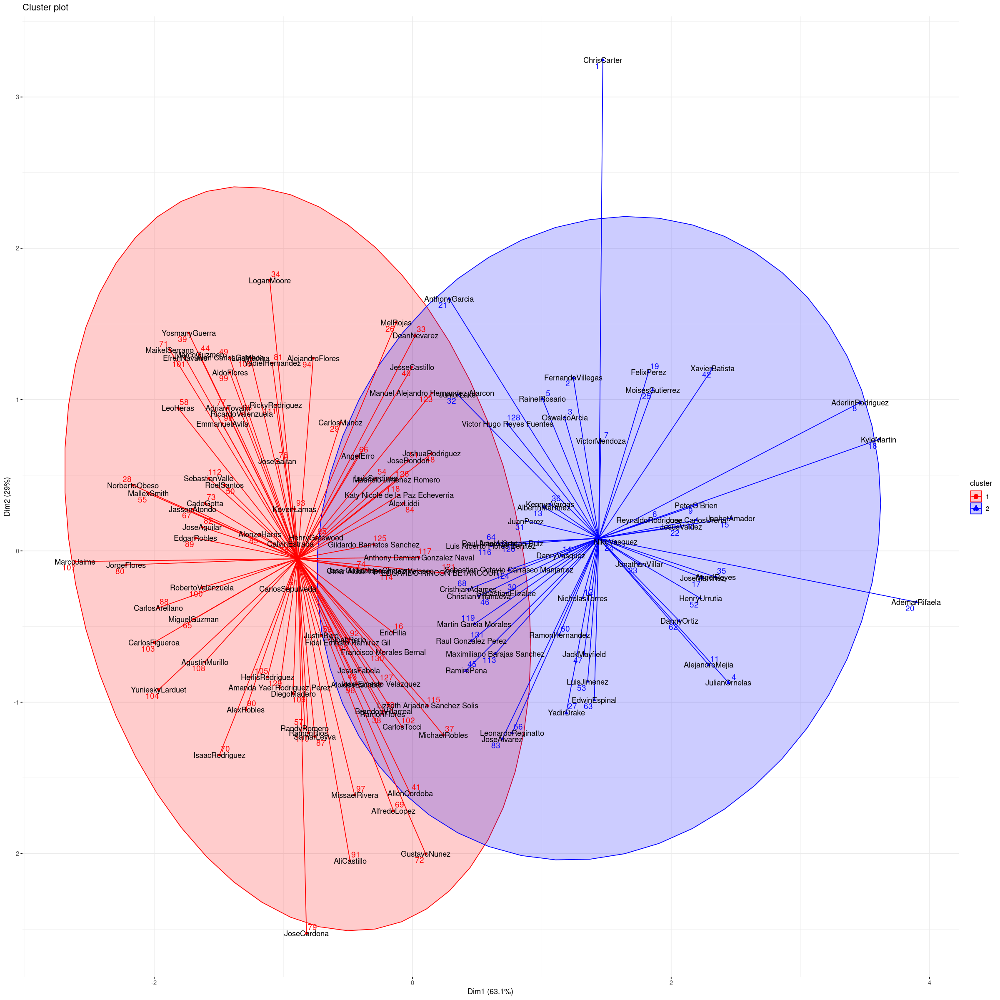

In [28]:
options(repr.plot.width=20, repr.plot.height=20)
basic_colors <- c("red", "blue", "green", "yellow", "purple", "orange", "cyan", "magenta", "brown", "black")
cluster_plot <- fviz_cluster(segmentos, data = bat2,
                            palette = basic_colors[1:2], 
                            ellipse.type = "norm",
                            star.plot = TRUE,
                            repel = TRUE,
                            ggtheme = theme_minimal() 
)
cluster_plot <- cluster_plot + 
  geom_text(aes(label = bateo[,3]))
print(cluster_plot)

In [29]:
segmentos<-kmeans(bat2,2)
asignacion<-cbind(bateo_2,cluster =segmentos$cluster)
head(asignacion,4)
write.csv(asignacion,"tabla_2_cluster2.csv")

,TB,HR,CI,cluster
,<int>,<int>,<int>,<int>
1,200,22,64,1
2,267,16,58,1
3,273,14,60,1
4,349,14,71,1


Ejercicio 3

In [30]:
bateo_3<-bateo[,-c(1,2,3,4,5,8,9,12,13,14,15,16,17,18,19,20,21)]
#normalizamos
bat3<-bateo_3
bat3<-as.data.frame(scale(bateo_3))
head(bat3)

,J,TB,X2B,X3B
,<dbl>,<dbl>,<dbl>,<dbl>
1,-2.0900861,-2.3500251,-0.4587520,-0.2387809
2,-0.3797189,-0.5468806,-1.2494955,1.1830507
3,0.7605259,-0.3854049,1.5181069,-0.2387809
4,1.1881177,1.6599531,3.0995940,0.4721349
5,-0.5222495,-0.4123175,0.3319916,-0.9496966
6,-0.2371883,0.5296236,0.5296775,-0.2387809


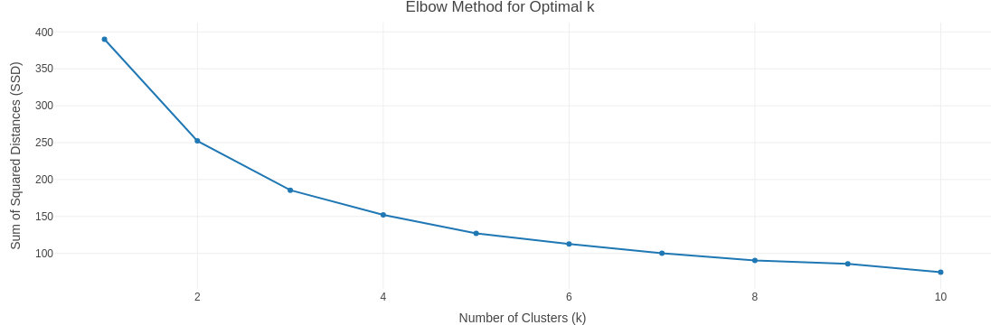

In [31]:
set.seed(123) 
bat3<-bateo_3
bat3<-as.data.frame(scale(bateo_3[,2:4]))
k_values <- 1:10
max_iterations <- 100
n_init <- 10
ssd <- numeric(length(k_values))
for (i in seq_along(k_values)) {
  k <- k_values[i]
  kmeans_result <- kmeans(bat3, centers = k, nstart = n_init, iter.max = max_iterations)
  ssd[i] <- kmeans_result$tot.withinss
}
elbow_data <- data.frame(k = k_values, ssd = ssd)
elbow_plot <- plot_ly(data = elbow_data, x = ~k, y = ~ssd, type = 'scatter', mode = 'lines+markers') %>%
  layout(title = "Elbow Method for Optimal k",
         xaxis = list(title = "Number of Clusters (k)"),
         yaxis = list(title = "Sum of Squared Distances (SSD)"))
elbow_plot

In [32]:
segmentos<-kmeans(bat3,3)
head(bat3)
segmentos

,TB,X2B,X3B
,<dbl>,<dbl>,<dbl>
1,-2.3500251,-0.4587520,-0.2387809
2,-0.5468806,-1.2494955,1.1830507
3,-0.3854049,1.5181069,-0.2387809
4,1.6599531,3.0995940,0.4721349
5,-0.4123175,0.3319916,-0.9496966
6,0.5296236,0.5296775,-0.2387809


K-means clustering with 3 clusters of sizes 54, 19, 58

Cluster means:
           TB        X2B        X3B
1 -0.82398073 -0.6674204 -0.3441017
2  0.04519674 -0.4275384  1.8191332
3  0.75234864  0.7614471 -0.2755524

Clustering vector:
  [1] 1 2 3 3 1 3 3 2 3 3 3 3 3 2 3 3 3 2 1 3 1 3 3 3 3 1 3 1 1 3 3 1 1 1 3 3 3
 [38] 3 1 1 3 1 2 2 3 3 3 1 1 2 1 3 3 1 2 3 3 2 2 3 1 3 3 1 1 1 1 3 2 2 1 2 2 3
 [75] 1 1 1 2 3 2 1 1 3 1 1 1 3 2 1 3 3 1 1 1 1 3 3 1 1 1 1 2 1 2 3 1 1 3 1 3 1
[112] 1 3 3 3 1 1 3 3 1 3 1 1 3 1 1 3 1 3 3 3

Within cluster sum of squares by cluster:
[1] 58.41482 47.35435 79.87010
 (between_SS / total_SS =  52.4 %)

Available components:

[1] "cluster"      "centers"      "totss"        "withinss"     "tot.withinss"
[6] "betweenss"    "size"         "iter"         "ifault"      

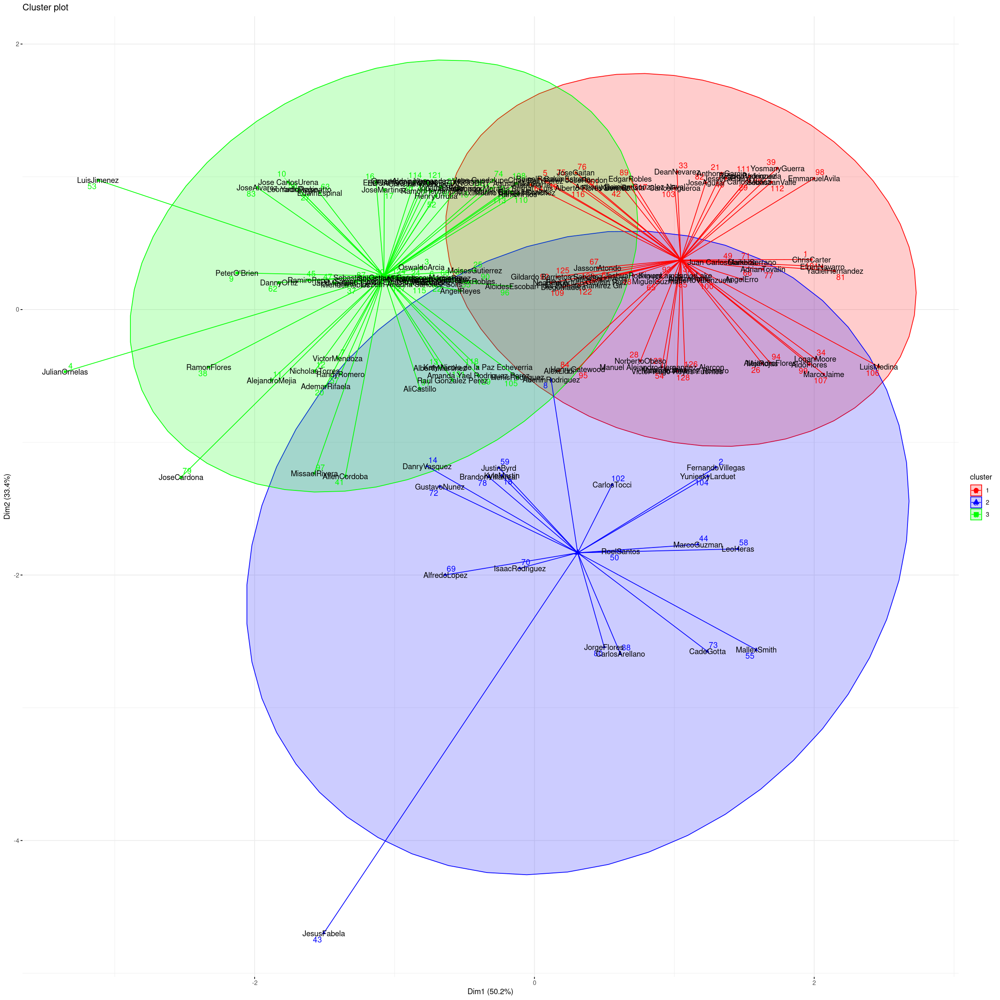

In [33]:
options(repr.plot.width=20, repr.plot.height=20)
basic_colors <- c("red", "blue", "green", "yellow", "purple", "orange", "cyan", "magenta", "brown", "black")
cluster_plot <- fviz_cluster(segmentos, data = bat3,
                            palette = basic_colors[1:5],  
                            ellipse.type = "norm",
                            star.plot = TRUE,
                            repel = TRUE,
                            ggtheme = theme_minimal()  
)
cluster_plot <- cluster_plot + 
  geom_text(aes(label = bateo[,3]))
print(cluster_plot)

In [34]:
segmentos<-kmeans(bat3,5)
asignacion<-cbind(bateo_3,cluster =segmentos$cluster)
head(asignacion,5)
write.csv(asignacion,"tabla_2_cluster3.csv")

,J,TB,X2B,X3B,cluster
,<int>,<int>,<int>,<int>,<int>
1,63,200,13,1,3
2,75,267,9,3,2
3,83,273,23,1,4
4,86,349,31,2,4
5,74,272,17,0,5


In [36]:
segmentos<-kmeans(bat3,5)
head(bat3)
segmentos

,TB,X2B,X3B
,<dbl>,<dbl>,<dbl>
1,-2.3500251,-0.4587520,-0.2387809
2,-0.5468806,-1.2494955,1.1830507
3,-0.3854049,1.5181069,-0.2387809
4,1.6599531,3.0995940,0.4721349
5,-0.4123175,0.3319916,-0.9496966
6,0.5296236,0.5296775,-0.2387809


K-means clustering with 5 clusters of sizes 40, 18, 34, 17, 22

Cluster means:
           TB        X2B        X3B
1  0.68033422  0.4011816 -0.4876014
2  0.01977928 -0.4148218  1.8939664
3 -0.31891498 -0.4703806 -0.3015087
4  0.93964509  1.6692785  0.1794049
5 -1.48637515 -0.9529667 -0.3357239

Clustering vector:
  [1] 5 2 4 4 3 1 4 3 4 4 4 4 4 2 1 1 1 2 3 1 5 1 1 1 1 5 1 3 5 1 1 3 5 5 1 1 1
 [38] 4 5 5 4 3 2 2 4 1 1 3 5 2 3 1 4 3 2 1 4 2 2 1 3 4 1 3 3 5 3 1 2 2 5 2 2 1
 [75] 3 3 5 2 4 2 5 3 4 3 3 5 1 2 3 1 1 3 3 5 3 1 4 5 5 3 5 2 3 2 3 5 5 1 3 1 5
[112] 5 1 1 1 3 3 1 1 3 1 3 3 1 3 3 1 3 1 1 1

Within cluster sum of squares by cluster:
[1] 28.54798 45.16289 24.82013 24.30197 16.96968
 (between_SS / total_SS =  64.2 %)

Available components:

[1] "cluster"      "centers"      "totss"        "withinss"     "tot.withinss"
[6] "betweenss"    "size"         "iter"         "ifault"      

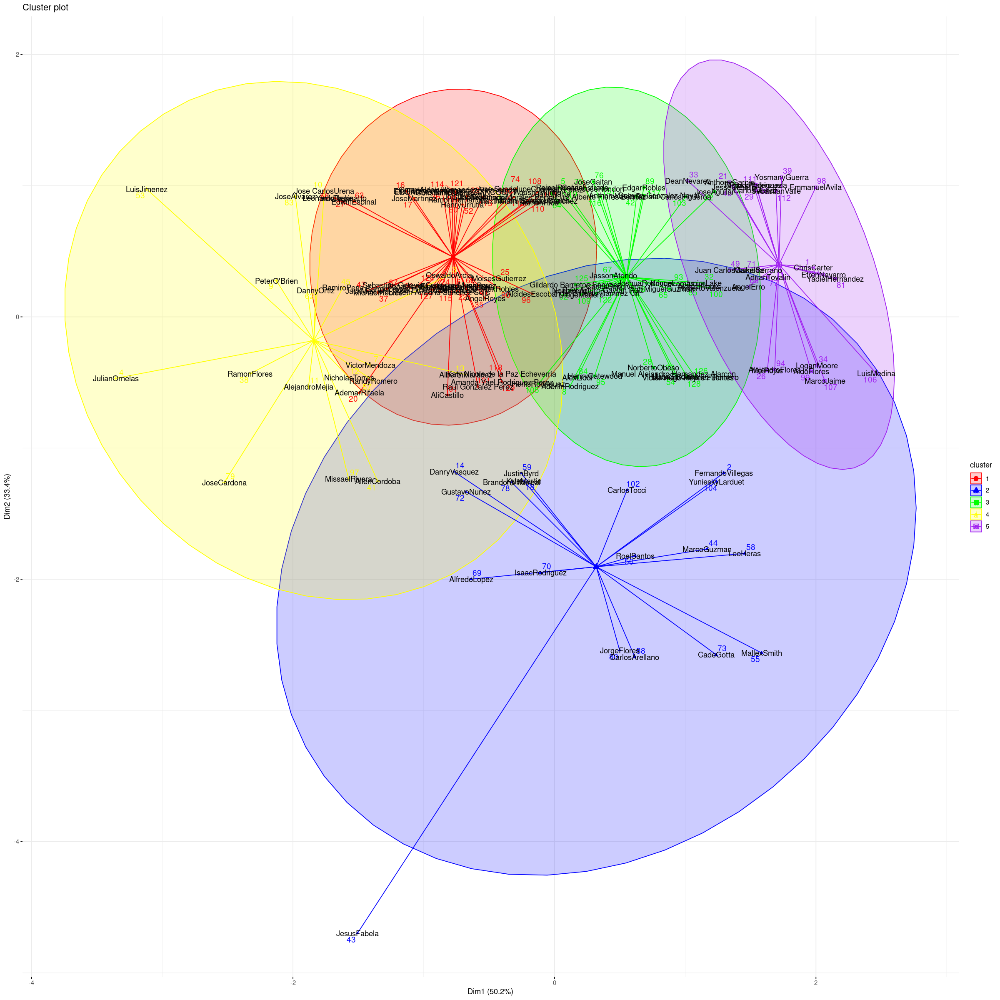

In [37]:
options(repr.plot.width=20, repr.plot.height=20)
basic_colors <- c("red", "blue", "green", "yellow", "purple", "orange", "cyan", "magenta", "brown", "black")
cluster_plot <- fviz_cluster(segmentos, data = bat3,
                            palette = basic_colors[1:5],  
                            ellipse.type = "norm",
                            star.plot = TRUE,
                            repel = TRUE,
                            ggtheme = theme_minimal()  
)
cluster_plot <- cluster_plot + 
  geom_text(aes(label = bateo[,3]))
print(cluster_plot)